## Imports and Global Parameters

In [1]:
import os
import re

import warnings
warnings.filterwarnings(action='ignore')

import numpy as np
import pandas as pd

import librosa
import audiomentations
import noisereduce

import librosa.display
import IPython.display as ipd

from sklearn.utils import shuffle
from PIL import Image
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf

# Global vars
RANDOM_SEED = 1337
SAMPLE_RATE = 32000
SIGNAL_LENGTH = 5 # seconds
SPEC_SHAPE = (48, 128) # height x width
FMIN = 500
FMAX = 12500
MAX_AUDIO_FILES = 1500

input_dir = 'basic_test/birds/'
output_dir = 'basic_test/melspectrogram_dataset/'
model_dir = 'basic_test/'
soundscape_dir = 'basic_test/'

## Select data
Find all bird species with more than 200 entries in the training data and save that data as TRAIN and LABELS

In [2]:
# Load metadata file
train = pd.read_csv('train_metadata.csv',)

# Limit the number of training samples and classes
# First, only use high quality samples
train = train.query('rating>=4')

# Second, assume that birds with the most training samples are also the most common
# A species needs at least 200 recordings with a rating above 4 to be considered common
birds_count = {}
for bird_species, count in zip(train.primary_label.unique(), 
                               train.groupby('primary_label')['primary_label'].count().values):
    birds_count[bird_species] = count
most_represented_birds = [key for key,value in birds_count.items() if value >= 200] 

TRAIN = train.query('primary_label in @most_represented_birds')
LABELS = sorted(TRAIN.primary_label.unique())

# Let's see how many species and samples we have left
print('NUMBER OF SPECIES IN TRAIN DATA:', len(LABELS))
print('NUMBER OF SAMPLES IN TRAIN DATA:', len(TRAIN))
print('LABELS:', most_represented_birds)

NUMBER OF SPECIES IN TRAIN DATA: 27
NUMBER OF SAMPLES IN TRAIN DATA: 8548
LABELS: ['amerob', 'barswa', 'bewwre', 'blujay', 'bncfly', 'carwre', 'compau', 'comrav', 'comyel', 'eursta', 'gbwwre1', 'grekis', 'houspa', 'houwre', 'mallar3', 'norcar', 'normoc', 'redcro', 'rewbla', 'roahaw', 'rubpep1', 'rucspa1', 'sonspa', 'spotow', 'wbwwre1', 'wesmea', 'yeofly1']


## Load single file
Load a single file and make a MEL spectogram just to visualize what the next part of the code does

SIGNAL SHAPE: (2333501,)


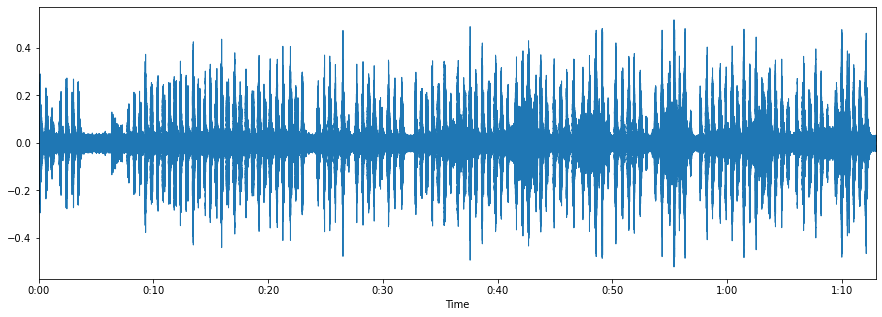

In [838]:
audio_index = 50
row = TRAIN.iloc[audio_index]
audio_path = os.path.join(input_dir, row.primary_label, row.filename)

sig, rate = librosa.load(audio_path, sr=32000, offset=None)
print('SIGNAL SHAPE:', sig.shape)

plt.figure(figsize=(15, 5))
librosa.display.waveplot(sig, sr=32000)
plt.show()

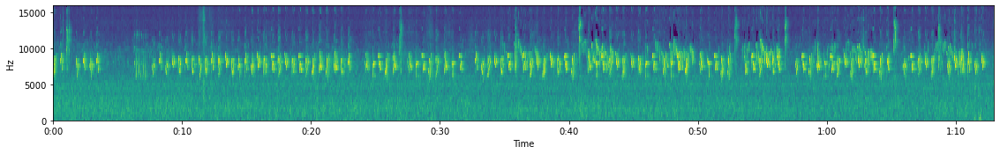

Spec shape: (48, 4558)


In [839]:
mel_spec = librosa.feature.melspectrogram(y=sig, 
                                            sr=rate, 
                                            n_fft=1024, 
                                            hop_length=512, 
                                            n_mels=SPEC_SHAPE[0], 
                                            fmin=FMIN, 
                                            fmax=FMAX)

mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

# Normalize
mel_spec -= mel_spec.min()
mel_spec /= mel_spec.max()

fig, ax = plt.subplots(figsize=(19.1,2.4))
librosa.display.specshow(mel_spec, 
                         sr=32000, 
                         x_axis='time', 
                         y_axis='hz', 
                         cmap=plt.get_cmap('viridis'))
plt.show()

print('Spec shape:',mel_spec.shape)

## Audio Data Augmentation

**Steps:**

1. Remove noise
2. More spectograms
    1. Time shift (forward and backwards)
    2. Time stretch (shorter and longer)
    3. Pitch shift (lower and higher)
3. Numerics
    1. BPM
    2. Harmonics

In [3]:
def load_audio_data(index, verbose=True):
    audio_index = index
    row = TRAIN.iloc[audio_index]
    audio_path = os.path.join(input_dir, row.primary_label, row.filename)

    sig, rate = librosa.load(audio_path, sr=32000, offset=None)
    
    if verbose:
        print(row.primary_label)
    return sig, rate

def plot_shift(sig, rate):
    mel_spec = librosa.feature.melspectrogram(y=sig, 
                                                sr=rate, 
                                                n_fft=1024, 
                                                hop_length=512, 
                                                n_mels=SPEC_SHAPE[0], 
                                                fmin=FMIN, 
                                                fmax=FMAX)
    
    mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

    # Normalize
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    
    fig, axes = plt.subplots(nrows=2, ncols=1, figsize=(20,7))
    
    librosa.display.waveplot(sig, sr=rate, ax=axes[0])
    librosa.display.specshow(mel_spec, 
                             sr=rate, 
                             x_axis='time', 
                             y_axis='hz', 
                             cmap=plt.get_cmap('viridis'), 
                             ax=axes[1])
    
    return ipd.Audio(data=sig, rate=rate)

In [9]:
sig, rate = load_audio_data(50)

amerob


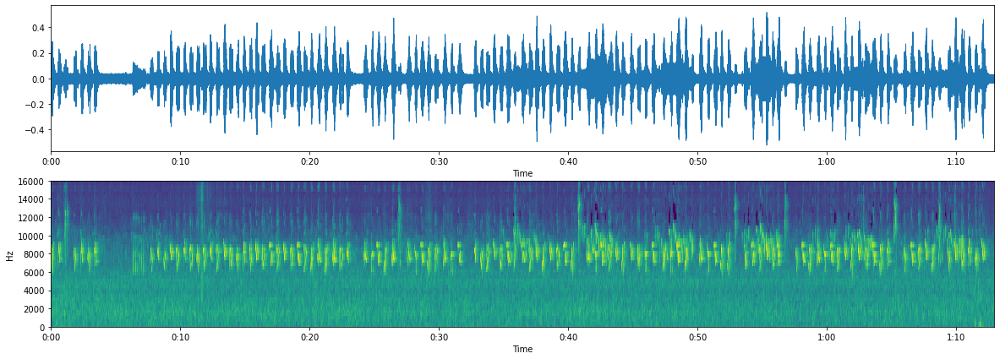

In [10]:
plot_shift(sig, rate)

### Noise reduction

In [15]:
def reduce_noise(sig, noise, use_tensorflow=True, verbose=False):
    return noisereduce.reduce_noise(sig, noise, use_tensorflow=use_tensorflow, verbose=verbose)

def get_chroma(sig, rate):
    norm = np.inf
    n_fft = 2048
    win_length = None
    return librosa.feature.chroma_stft(y=sig, sr=rate, norm=norm, n_fft=n_fft, win_length=win_length)

def clean_chroma(sig, rate, method=np.mean, threshold=0.9):
    chroma = get_chroma(sig, rate)
    return chroma.T[np.where(method(chroma, axis=0) < threshold)].T

amerob


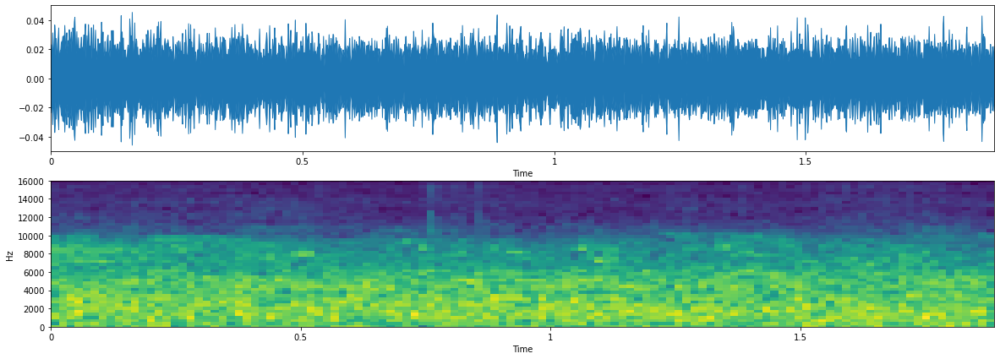

In [5]:
sig, rate = load_audio_data(50)
noise = sig[120000:180000]

audio2 = plot_shift(noise, rate)
ipd.display(audio2)

amerob


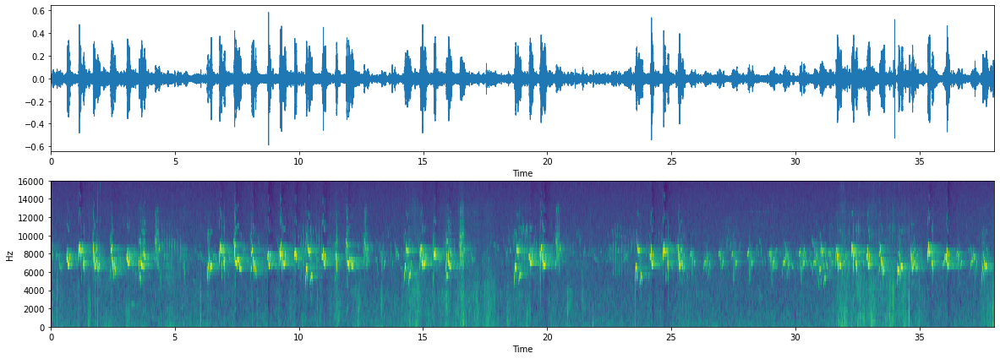

In [15]:
sig, rate = load_audio_data(13)
audio1 = plot_shift(sig, rate)
ipd.display(audio1)

In [17]:
reduced_noise = reduce_noise(sig, noise)

Original audio:


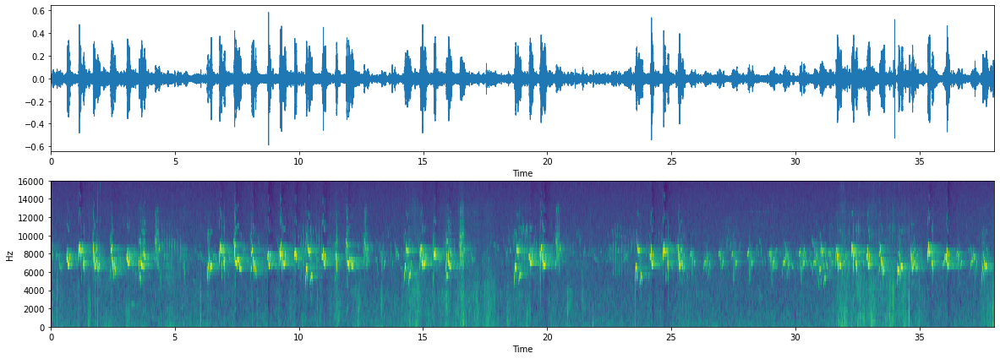


Noise reduced:


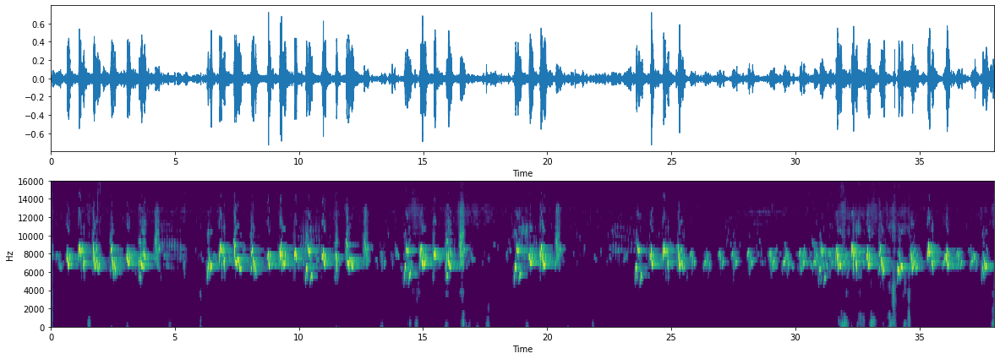

In [18]:
print('Original audio:')
ipd.display(audio1)
plot_shift(sig, rate)
plt.show()
print()
audio3 = plot_shift(reduced_noise, rate)
print('Noise reduced:')
ipd.display(audio3)

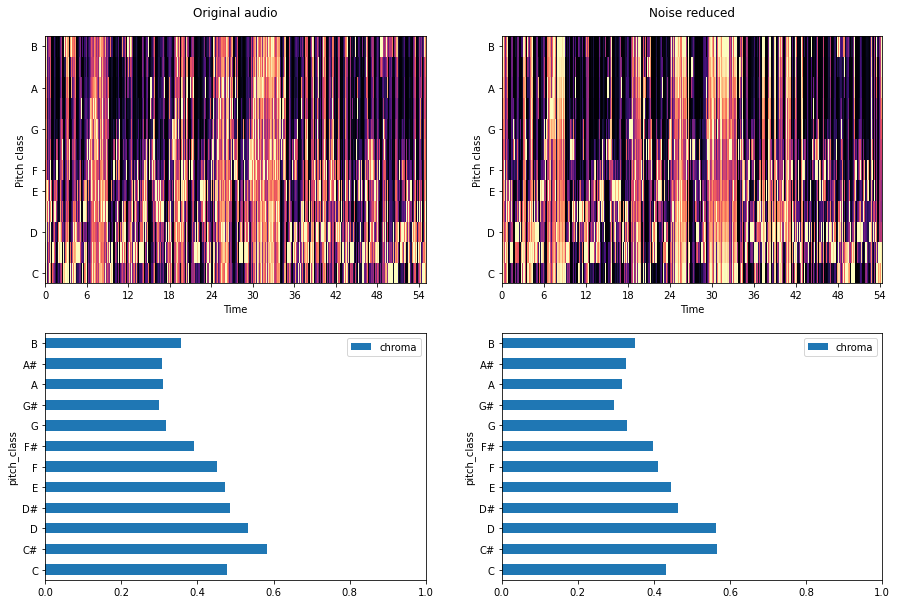

In [28]:
chroma1 = clean_chroma(sig, rate)
chroma2 = clean_chroma(reduced_noise, rate)

fig, axes = plt.subplots(nrows=2,ncols=2,figsize = (15, 10))

img = librosa.display.specshow(chroma1, y_axis='chroma', x_axis='time', ax=axes[0][0])
axes[0][0].set_title('Original audio', pad=20)

img = librosa.display.specshow(chroma2, y_axis='chroma', x_axis='time', ax=axes[0][1])
axes[0][1].set_title('Noise reduced', pad=20)

chromasum1 = pd.DataFrame({'chroma' : chroma1.mean(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum1.plot(kind='barh', y='chroma', x='pitch_class', ax=axes[1][0])
axes[1][0].set_xlim(0,1)

chromasum2 = pd.DataFrame({'chroma' : chroma2.mean(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum2.plot(kind='barh', y='chroma', x='pitch_class', ax=axes[1][1])
axes[1][1].set_xlim(0,1)

plt.show()

### Audio modifications

#### ~Add noise~

**Pink noise**

In [234]:
import colorednoise as cn
beta = 2 # the exponent
samples = len(sig) # number of samples to generate
y = cn.powerlaw_psd_gaussian(beta, samples)

In [235]:
sig_pink_noise = sig + y

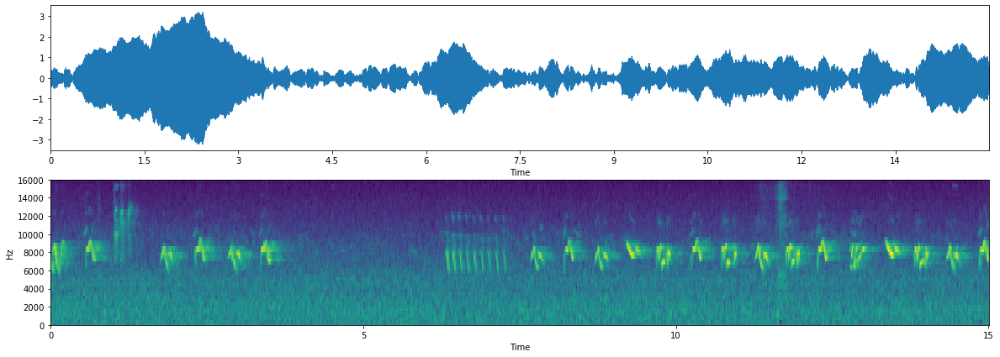

In [236]:
plot_shift(sig_pink_noise, rate)

**Random noise**

In [207]:
sig_random_noise = sig + 0.009*np.random.normal(0,1,len(sig))

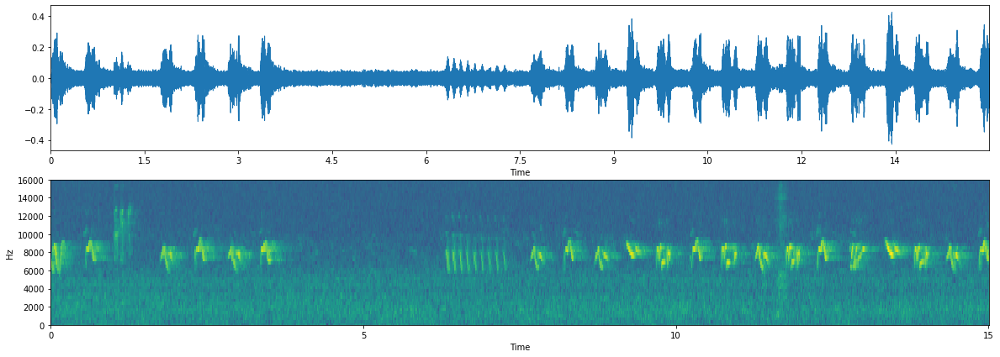

In [208]:
plot_shift(sig_random_noise, rate)

#### Time shift

In [69]:
def time_shift(sig, rate, roll=0.1):
    return np.roll(sig, int(rate/roll))

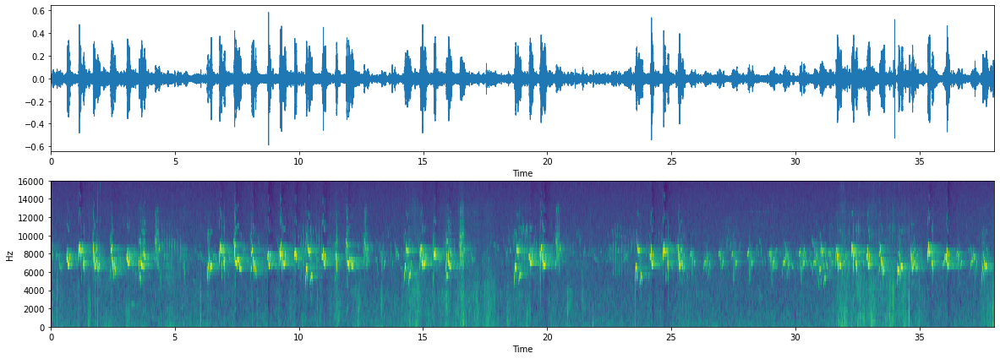

In [70]:
plot_shift(sig, rate)

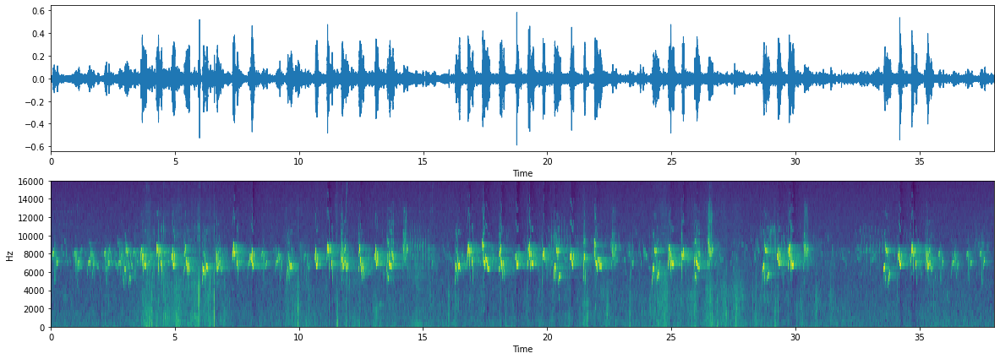

In [75]:
wav_roll = time_shift(sig, rate, roll = 0.1)
plot_shift(wav_roll, rate)

#### Time stretch

In [40]:
def time_stretch(sig, factor):
    return librosa.effects.time_stretch(sig,factor)

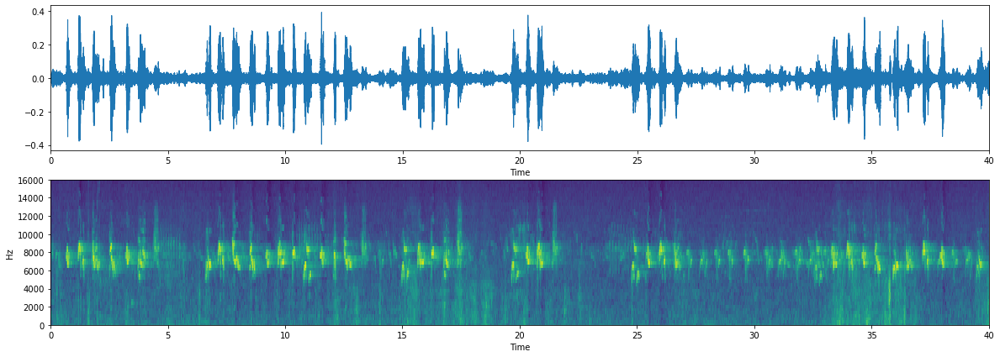

In [41]:
factor = 0.95
wav_time_stch = time_stretch(sig, factor)
plot_shift(wav_time_stch, rate)

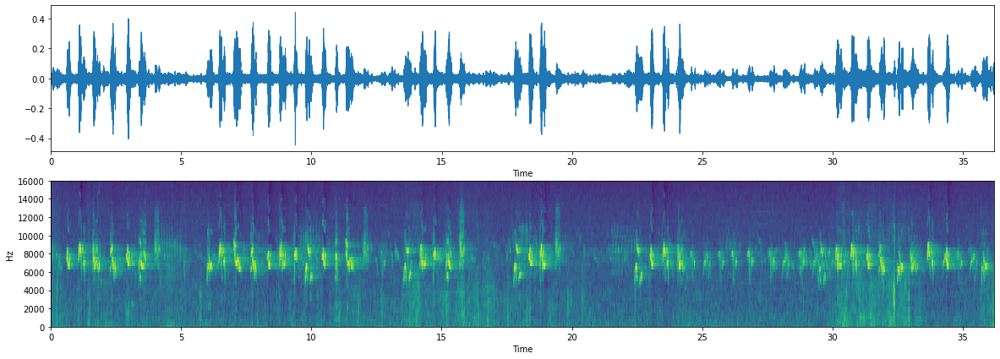

In [42]:
factor = 1.05
wav_time_stch = librosa.effects.time_stretch(sig,factor)
plot_shift(wav_time_stch, rate)

#### Pitch shift

In [76]:
def pitch_shift(sig, rate, n_steps):
    return librosa.effects.pitch_shift(sig, rate, n_steps=n_steps)

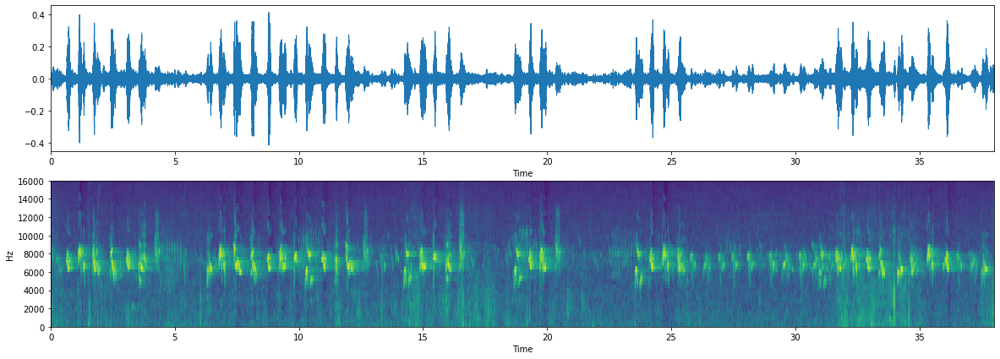

In [83]:
wav_pitch_sf = pitch_shift(sig, rate, -1)
plot_shift(wav_pitch_sf, rate)

### Extracting other audio dimensions

#### BPM

In [6]:
def bpm(sig, rate):
    return librosa.beat.beat_track(y=sig, sr=rate)

In [185]:
tempo, beat_frames = bpm(sig, rate)
tempo

104.16666666666667

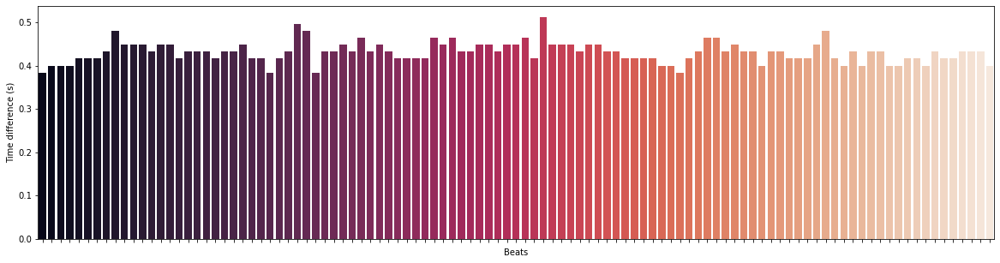

In [931]:
beat_times = librosa.frames_to_time(beat_frames, sr=rate)
beat_time_diff = np.ediff1d(beat_times)
beat_nums = np.arange(1, np.size(beat_times))
fig, ax = plt.subplots()
fig.set_size_inches(20, 5)
ax.set_ylabel("Time difference (s)")
ax.set_xlabel("Beats")
g = sns.barplot(beat_nums, beat_time_diff, palette="rocket",ax=ax)
g = g.set(xticklabels=[])

In [86]:
for idx in tqdm(range(len(TRAIN)), smoothing=0):
    try:
        sig, rate = load_audio_data(idx)
        tempo, beat_frames = librosa.beat.beat_track(y=sig, sr=rate)
        TRAIN.at[idx, 'tempo'] = tempo
    except FileNotFoundError:
        pass

100%|██████████████████████████████████████████████████████████████████████████████| 8548/8548 [08:44<00:00, 16.31it/s]


In [117]:
tempo_mean = TRAIN[~TRAIN['tempo'].isna()].groupby('primary_label')['tempo'].mean().sort_values(ascending=False).index
tempo_mean = tempo_mean.sort_values(ascending=False)
order = tempo_mean.index
tempo_std = TRAIN[~TRAIN['tempo'].isna()].groupby('primary_label')['tempo'].std()[order]

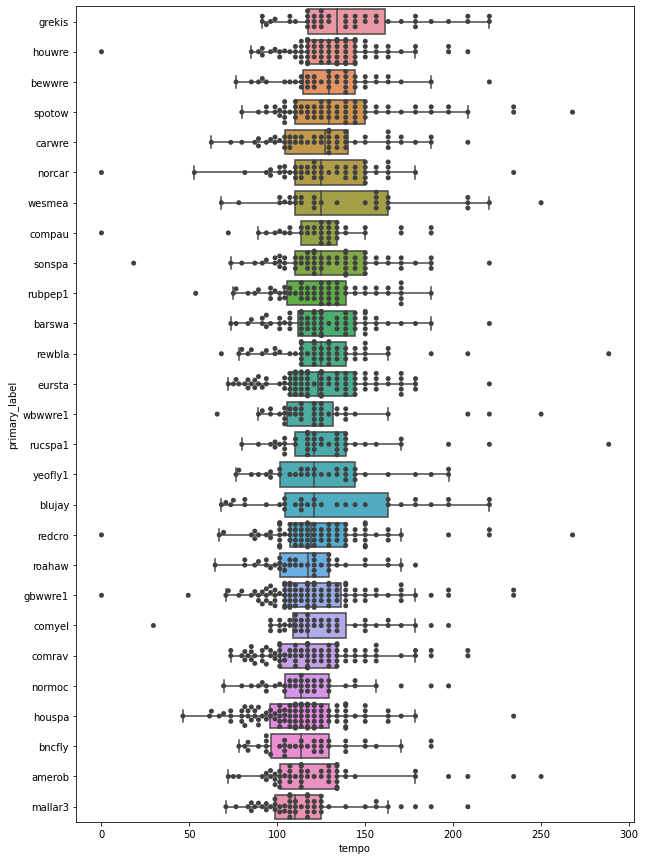

In [665]:
data = TRAIN[~TRAIN['tempo'].isna()]
order = data.groupby('primary_label')['tempo'].median().sort_values(ascending=False).index
fig, ax = plt.subplots(figsize=(10,15))
sns.boxplot(x=data['tempo'], y=data['primary_label'], order=order, fliersize=2, orient='h', ax=ax,)
sns.swarmplot(x=data['tempo'], y=data['primary_label'], order=order, color=".25", ax=ax)
plt.show()

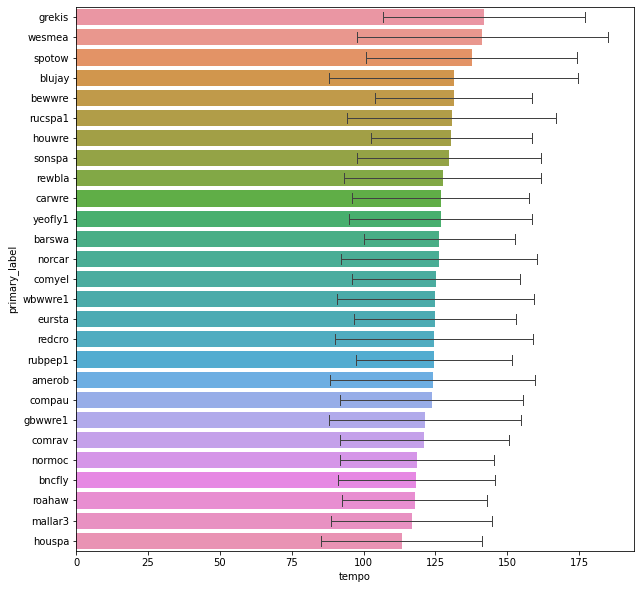

In [650]:
data = TRAIN[~TRAIN['tempo'].isna()]
order = data.groupby('primary_label')['tempo'].mean().sort_values(ascending=False).index
fig, ax = plt.subplots(figsize=(10,10))
sns.barplot(x=data['tempo'], y=data['primary_label'], order=order, ci='sd', errwidth=1, capsize=0.5, orient='h', ax=ax,)
plt.show()

#### Harmonics

In [555]:
sig, rate = load_audio_data(50)

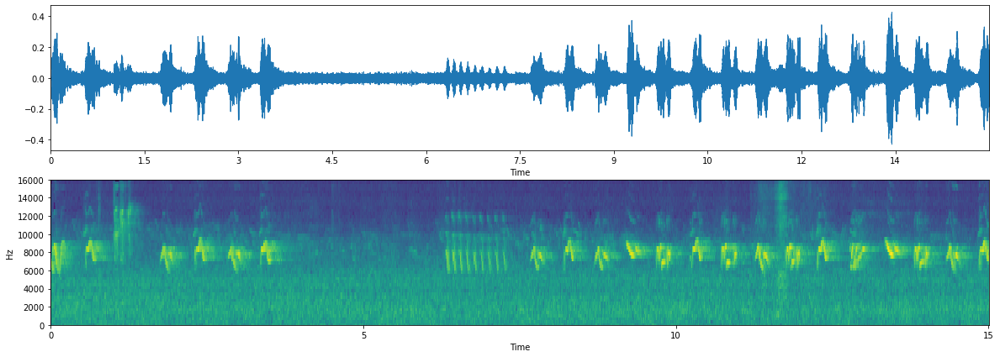

In [556]:
plot_shift(sig, rate)

[Text(0.5, 1.0, 'Chromagram')]

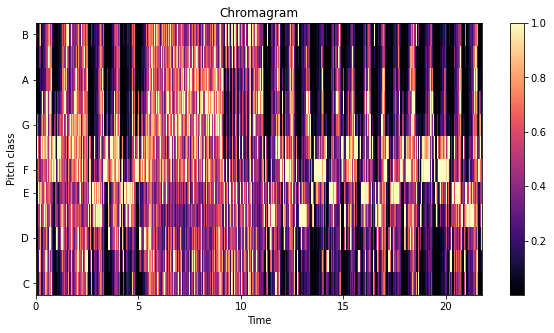

In [573]:
chroma=librosa.feature.chroma_stft(y=sig, sr=rate)
fig, ax = plt.subplots(1,figsize = (10, 5))
img = librosa.display.specshow(chroma, y_axis='chroma', x_axis='time', ax=ax)
fig.colorbar(img, ax=ax)
ax.set(title='Chromagram')

<AxesSubplot:ylabel='pitch_class'>

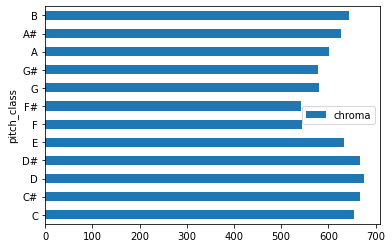

In [554]:
chromasum = pd.DataFrame({'chroma' : chroma.sum(axis=1), 'pitch_class': ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B']})
chromasum.plot(kind='barh', y='chroma', x='pitch_class')

In [408]:
chroma.sum(axis=1)/max(chroma.sum(axis=1))

array([0.6141976 , 0.59643215, 0.85717565, 0.955208  , 0.89410293,
       1.        , 0.8559039 , 0.82035583, 0.9109652 , 0.9128629 ,
       0.8371323 , 0.7121173 ], dtype=float32)

In [923]:
df = pd.DataFrame()

for idx in tqdm(range(len(TRAIN)), smoothing=0):
    try:
        sig, rate = load_audio_data(idx, verbose=False)
        chroma = librosa.feature.chroma_stft(y=sig, sr=rate)
        chromasum = pd.DataFrame(chroma.mean(axis=1)).T
        chromasum['specie'] = TRAIN.iloc[idx]['primary_label']
        df = pd.concat([df, chromasum])
    except FileNotFoundError:
        pass
    
df.columns = ['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B','specie']
df = df.reset_index(drop=True)

  0%|          | 0/8548 [00:00<?, ?it/s]

In [925]:
data = df.melt(id_vars='specie')

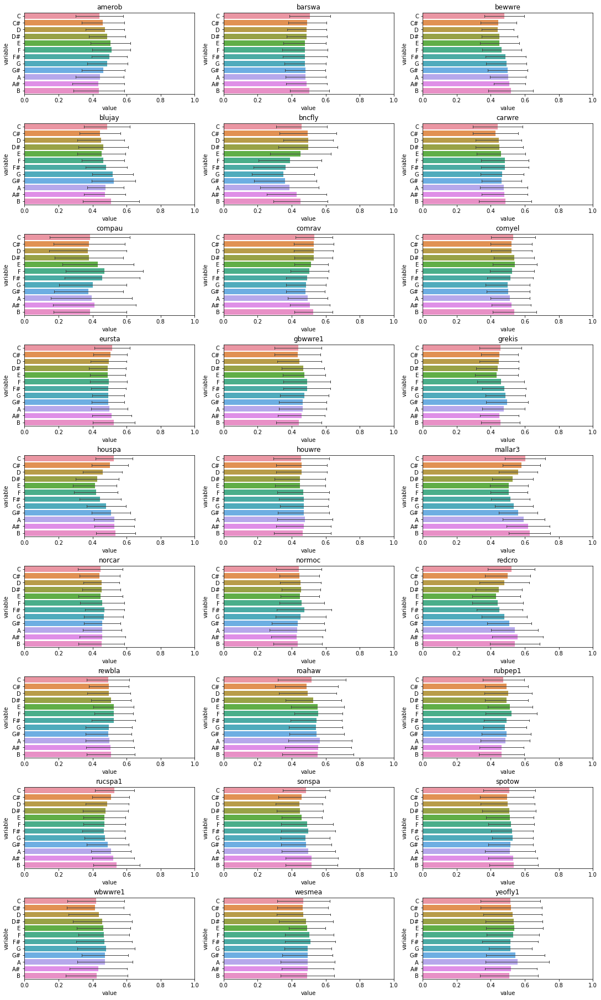

In [926]:
n_rows = 9
n_cols = 3

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15,25), constrained_layout=True)

for specie, ax in zip(data['specie'].unique(), axes.flatten()):
    row = data[data['specie'] == specie]
    sns.barplot(x=row['value'], y=row['variable'], ci='sd', errwidth=1, capsize=0.3, orient='h', ax = ax)
    ax.set(title=specie)
    ax.set(xlim=(0,1))
plt.show()

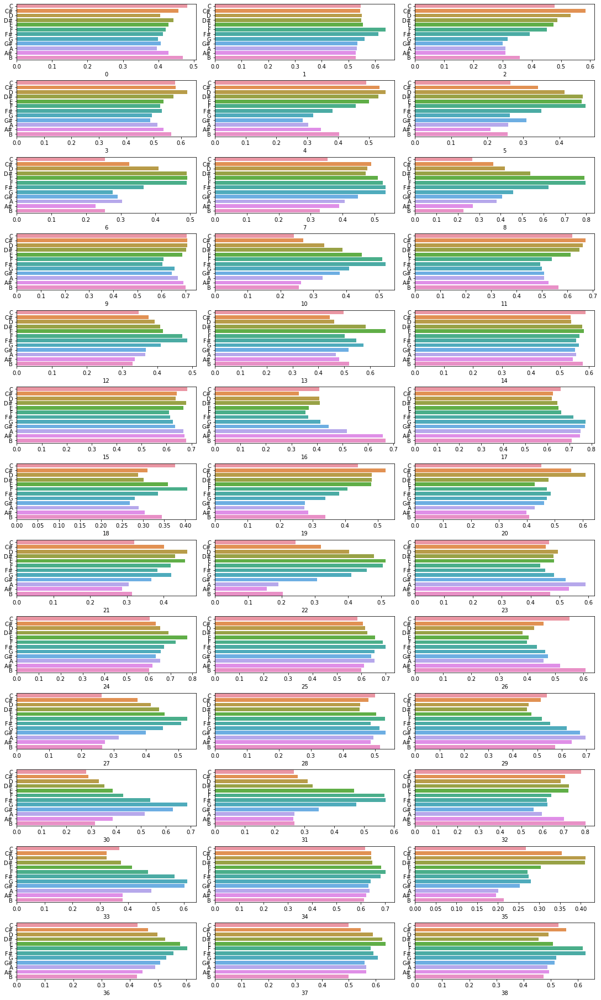

In [927]:
n_rows = 13
n_cols = 3
specie = 'amerob'

fig, axes = plt.subplots(nrows=n_rows, ncols=n_cols, figsize=(15,25), constrained_layout=True)

for ax, (index, row) in zip(axes.flatten(), df[df['specie'] == specie].iterrows()):
    row = row[:-1]
    sns.barplot(x=row, y=row.index, ax=ax, orient='h')    

## Define load function
Load a specified portion of the the selected training data (MAX_AUDIO_FILES) and have librosa generate MEL spectograms of it in sections of a specifieed number of seconds (SIGNAL_LENGTH)

In [7]:
from audiomentations import Compose, TimeStretch, PitchShift, Shift

In [8]:
# Shuffle the training data and limit the number of audio files to MAX_AUDIO_FILES
TRAIN = shuffle(TRAIN, random_state=RANDOM_SEED)[:MAX_AUDIO_FILES]

augment = Compose([
    TimeStretch(min_rate=0.95, max_rate=1.05, p=0.5),
    PitchShift(min_semitones=-1, max_semitones=1, p=0.5),
    Shift(min_fraction=-0.5, max_fraction=0.5, p=0.5),
])

# Get mel_spec
def get_mel_spec(sig):
    hop_length = int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))
    mel_spec = librosa.feature.melspectrogram(y=sig, 
                                              sr=SAMPLE_RATE, 
                                              n_fft=1024, 
                                              hop_length=hop_length, 
                                              n_mels=SPEC_SHAPE[0], 
                                              fmin=FMIN, 
                                              fmax=FMAX)

    mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

    # Normalize
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    
    return mel_spec

# Define a function that splits an audio file, 
# extracts spectrograms and saves them in a working directory
def get_spectrograms(filepath, primary_label, output_dir):
    
    # Open the file with librosa (limited to the first 15 seconds)
    sig, rate = librosa.load(filepath, sr=SAMPLE_RATE, offset=None, duration=15)
    
    # Split signal into five second chunks
    sig_splits = []
    for i in range(0, len(sig), int(SIGNAL_LENGTH * SAMPLE_RATE)):
        split = sig[i:i + int(SIGNAL_LENGTH * SAMPLE_RATE)]

        # End of signal?
        if len(split) < int(SIGNAL_LENGTH * SAMPLE_RATE):
            break
        
        sig_splits.append(split)
        
    # Extract mel spectrograms for each audio chunk
    s_cnt = 0
    saved_samples = []
    for chunk in sig_splits:
        
        # Reduce noise
        chunk = reduce_noise(chunk, noise)
        
        results = [(chunk, '')]
        
        for n in range(5):
            results.append((augment(chunk, rate), f'aug{n}'))
        
        for result, image_name in results:
            mel_spec = get_mel_spec(result)
           
            # Save as image file
            save_dir = os.path.join(output_dir, primary_label)
            if not os.path.exists(save_dir):
                os.makedirs(save_dir)
            save_path = os.path.join(save_dir, 
                                     filepath.rsplit(os.sep, 1)[-1].rsplit('.', 1)[0] + '_' + str(s_cnt) + '_' + image_name + '.png')
            
            im = Image.fromarray(mel_spec * 255.0).convert("L")
            im.save(save_path)
            
            chroma = clean_chroma(chunk, rate)
            chromasum = {k:v for k, v in zip(['C', 'C#', 'D', 'D#', 'E', 'F', 'F#', 'G', 'G#', 'A', 'A#', 'B'], chroma.mean(axis=1))}
            
            tempo, _ = bpm(chunk, rate)
            
            numeric_data = {
                'bpm' : tempo,
                **chromasum
            }
            
            saved_samples.append({save_path:numeric_data})
        s_cnt += 1
        
    return saved_samples

print('FINAL NUMBER OF AUDIO FILES IN TRAINING DATA:', len(TRAIN))

FINAL NUMBER OF AUDIO FILES IN TRAINING DATA: 1500


## Load spectograms
Run the load function

In [9]:
import joblib

In [12]:
# Parse audio files and extract training samples
specto_paths = []
for idx, row in tqdm(TRAIN.iterrows(), total=len(TRAIN), smoothing=0.01):
    if row.primary_label in most_represented_birds:
        audio_file_path = os.path.join(input_dir, row.primary_label, row.filename)
        specto_paths.append((audio_file_path, row.primary_label, output_dir))

jobs = [ joblib.delayed(get_spectrograms)(i, c, o) for i,c,o in specto_paths]

  0%|          | 0/1500 [00:00<?, ?it/s]

In [24]:
out = joblib.Parallel(n_jobs=8, verbose=10)(jobs[:80])

[Parallel(n_jobs=8)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=8)]: Done   2 tasks      | elapsed:   16.9s
[Parallel(n_jobs=8)]: Done  56 tasks      | elapsed:  2.9min
[Parallel(n_jobs=8)]: Done  80 out of  80 | elapsed:  4.1min finished


In [25]:
samples= [x for y in out for x in y]
TRAIN_SPECS = shuffle(samples, random_state=RANDOM_SEED)
print('SUCCESSFULLY EXTRACTED {} SPECTROGRAMS'.format(len(TRAIN_SPECS)))

SUCCESSFULLY EXTRACTED 1380 SPECTROGRAMS


## Plot spectograms

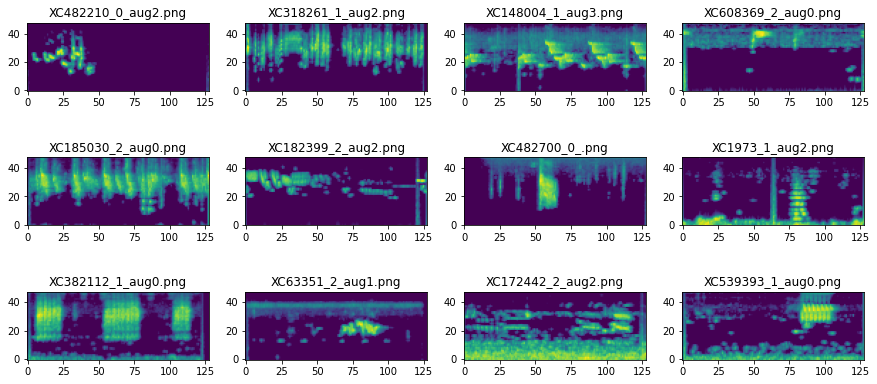

In [26]:
# Plot the first 12 spectrograms of TRAIN_SPECS
plt.figure(figsize=(15, 7))
for i in range(12):
    file = list(TRAIN_SPECS[i].keys())[0]
    spec = Image.open(file)
    plt.subplot(3, 4, i + 1)
    plt.title(file.split(os.sep)[-1])
    plt.imshow(spec, origin='lower')

## Load data
Load spectograms and normalize, and add to a stack of 4154 sound bites, of 48 (MEL resolution) x 128 (time resolution) pixels. Labels are 4154 one-hot vectors of length 27 (number of bird types)

In [89]:
# Parse all samples and add spectrograms into train data, primary_labels into label data
train_specs, train_labels = [], []
for path in tqdm(TRAIN_SPECS, total=len(TRAIN_SPECS), smoothing=0.01):
    path = list(path.keys())[0]

    # Open image
    spec = Image.open(path)

    # Convert to numpy array
    spec = np.array(spec, dtype='float32')

    # Normalize between 0.0 and 1.0
    # and exclude samples with nan 
    spec -= spec.min()
    spec /= spec.max()
    if not spec.max() == 1.0 or not spec.min() == 0.0:
        continue

    # Add channel axis to 2D array
    spec = np.expand_dims(spec, -1)

    # Add new dimension for batch size
    spec = np.expand_dims(spec, 0)

    # Add to train data
    if len(train_specs) == 0:
        train_specs = spec
    else:
        train_specs = np.vstack((train_specs, spec))

    # Add to label data
    target = np.zeros((len(LABELS)), dtype='float32')
    bird = path.replace(os.sep, '/').split('/')[-2]
    target[LABELS.index(bird)] = 1.0
    if len(train_labels) == 0:
        train_labels = target
    else:
        train_labels = np.vstack((train_labels, target))

  0%|          | 0/1380 [00:00<?, ?it/s]

## Building model
Input layers dimensions are 48x128 (spec resolution) and output length is 27

Two different ways of implementing mixed inputs
Add to the dense layers of a convoluted network  
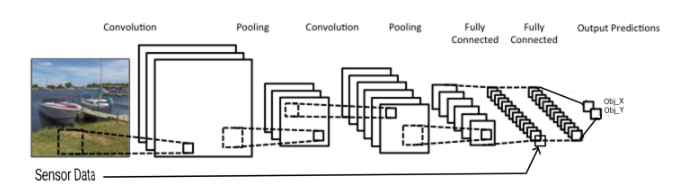

Create two different models and concatenate them (https://www.pyimagesearch.com/2019/02/04/keras-multiple-inputs-and-mixed-data/)  
<img src="https://pyimagesearch.com/wp-content/uploads/2019/02/keras_multi_input_design.png" alt="drawing" width="400"/>




In [28]:
# Add callbacks to reduce the learning rate if needed, early stopping, and checkpoint saving
callbacks = [tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', 
                                                  patience=2, 
                                                  verbose=1, 
                                                  factor=0.5),
             tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                              verbose=1,
                                              patience=5),
             tf.keras.callbacks.ModelCheckpoint(filepath=model_dir + 'best_model.h5', 
                                                monitor='val_loss',
                                                verbose=0,
                                                save_best_only=True)]

### Functional multi-input

In [21]:
from tensorflow.keras.layers import BatchNormalization, Conv2D, MaxPooling2D, Activation, Dropout, Dense, Flatten, Input, GlobalAveragePooling2D, Concatenate
from tensorflow.keras.models import Model

#### CNN

In [22]:
def create_cnn(output=False):
    cnn_inputs = Input(shape=(SPEC_SHAPE[0], SPEC_SHAPE[1], 1))

    cnn = cnn_inputs

    # Define number of neurons and filter size for the convoluted blocks
    blocks = (
        (16, (3,3)),
        (32, (3,3)),
        (64, (3,3)),
        (128, (3,3)),
    )

    # Create the convoluted blocks
    for block in blocks:
        # Convoluted layer
        cnn = Conv2D(block[0], block[1])(cnn)
        # Batch normalization
        cnn = BatchNormalization()(cnn)
        # Max pooling
        cnn = MaxPooling2D((2, 2))(cnn)

    # Global pooling
    cnn = GlobalAveragePooling2D()(cnn)

    # Dense block
    cnn = Dense(256, activation='relu')(cnn)
    cnn = Dropout(0.5)(cnn)
    # Dense block
    cnn = Dense(256, activation='relu')(cnn)
    cnn = Dropout(0.5)(cnn)

    if output==True:
        # Classification layer
        cnn = Dense(len(LABELS), activation='softmax')(cnn)

    cnn = Model(cnn_inputs, cnn)
    
    return cnn

In [29]:
cnn = create_cnn(output=True)

cnn.compile(optimizer=tf.keras.optimizers.Adam(lr=0.01),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

cnn.fit(train_specs, 
        train_labels,
        batch_size=32,
        validation_split=0.2,
        callbacks=callbacks,
        epochs=100)

Epoch 1/100
35/35 [==============================] - 10s 238ms/step - loss: 3.4701 - accuracy: 0.1202 - val_loss: 2.8128 - val_accuracy: 0.2138
Epoch 2/100
35/35 [==============================] - 8s 228ms/step - loss: 2.9113 - accuracy: 0.1681 - val_loss: 3.1716 - val_accuracy: 0.2210
Epoch 3/100
35/35 [==============================] - 9s 250ms/step - loss: 2.6813 - accuracy: 0.1892 - val_loss: 2.8582 - val_accuracy: 0.1413

Epoch 00003: ReduceLROnPlateau reducing learning rate to 0.004999999888241291.
Epoch 4/100
35/35 [==============================] - 8s 239ms/step - loss: 2.4569 - accuracy: 0.2436 - val_loss: 2.5084 - val_accuracy: 0.2246
Epoch 5/100
35/35 [==============================] - 8s 241ms/step - loss: 2.2794 - accuracy: 0.3057 - val_loss: 2.2329 - val_accuracy: 0.3696
Epoch 6/100
35/35 [==============================] - 8s 242ms/step - loss: 2.1556 - accuracy: 0.3316 - val_loss: 2.1971 - val_accuracy: 0.3261
Epoch 7/100
35/35 [==============================] - 9s 244ms

KeyboardInterrupt: 

#### MLP

In [31]:
from sklearn.preprocessing import normalize

In [32]:
num_data = np.array([list(list(x.values())[0].values()) for x in TRAIN_SPECS])
num_data = normalize(num_data, axis=0)

In [33]:
def create_mlp(output=False):
    mlp_inputs = Input(shape=(num_data.shape[1]))

    mlp = mlp_inputs

    mlp = Dense(13, activation="relu")(mlp)
    mlp = Dense(13, activation="sigmoid")(mlp)
    
    # Classification layer
    if output==True:
         mlp = Dense(len(LABELS), activation='softmax')(mlp)

    mlp = Model(mlp_inputs, mlp)
    
    return mlp

In [38]:
mlp = create_mlp(output=True)

mlp.compile(optimizer=tf.keras.optimizers.Adam(lr=0.01),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

mlp.fit(num_data,
        train_labels,
        batch_size=32,
        validation_split=0.2,
        callbacks=callbacks,
        epochs=100)

Epoch 1/100
35/35 [==============================] - 1s 10ms/step - loss: 3.2393 - accuracy: 0.0721 - val_loss: 3.0237 - val_accuracy: 0.0797
Epoch 2/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0603 - accuracy: 0.0844 - val_loss: 3.0205 - val_accuracy: 0.0797
Epoch 3/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0695 - accuracy: 0.1013 - val_loss: 3.0178 - val_accuracy: 0.0978
Epoch 4/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0844 - accuracy: 0.0732 - val_loss: 3.0051 - val_accuracy: 0.0797
Epoch 5/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0623 - accuracy: 0.0895 - val_loss: 3.0054 - val_accuracy: 0.0870
Epoch 6/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0414 - accuracy: 0.0997 - val_loss: 2.9785 - val_accuracy: 0.1051
Epoch 7/100
35/35 [==============================] - 0s 3ms/step - loss: 3.0474 - accuracy: 0.0939 - val_loss: 2.9291 - val_accuracy: 0.0978
Epoch 8/100


In [73]:
mlp.summary()
mlp.layers[-2].output

Model: "model_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 13)]              0         
_________________________________________________________________
dense_30 (Dense)             (None, 13)                182       
_________________________________________________________________
dense_31 (Dense)             (None, 13)                182       
Total params: 364
Trainable params: 364
Non-trainable params: 0
_________________________________________________________________


<KerasTensor: shape=(None, 13) dtype=float32 (created by layer 'dense_30')>

#### Combine

In [75]:
cnn = create_cnn()
mlp = create_mlp()

merged = Concatenate(axis=1)([cnn.output, mlp.output])

dense1 = Dense(16, input_dim=2, activation='sigmoid', use_bias=True)(merged)
output = Dense(len(LABELS), activation='softmax', use_bias=True)(dense1)

mixed = Model(inputs=[cnn.input, mlp.input], outputs=output)

In [76]:
# Compile the model and specify optimizer, loss and metric
mixed.compile(optimizer=tf.keras.optimizers.Adam(lr=0.001),
              loss=tf.keras.losses.CategoricalCrossentropy(label_smoothing=0.01),
              metrics=['accuracy'])

In [77]:
# Let's train the model for a few epochs
mixed.fit([train_specs, num_data], 
          train_labels,
          batch_size=32,
          validation_split=0.2,
          callbacks=callbacks,
          epochs=25)

Epoch 1/25
35/35 [==============================] - 9s 232ms/step - loss: 3.2638 - accuracy: 0.0608 - val_loss: 3.1585 - val_accuracy: 0.0580
Epoch 2/25
35/35 [==============================] - 8s 229ms/step - loss: 3.0444 - accuracy: 0.1599 - val_loss: 3.0831 - val_accuracy: 0.1522
Epoch 3/25
35/35 [==============================] - 9s 248ms/step - loss: 2.8712 - accuracy: 0.2696 - val_loss: 3.0551 - val_accuracy: 0.0978
Epoch 4/25
35/35 [==============================] - 8s 243ms/step - loss: 2.7085 - accuracy: 0.3335 - val_loss: 3.0802 - val_accuracy: 0.0978
Epoch 5/25
35/35 [==============================] - 9s 265ms/step - loss: 2.5099 - accuracy: 0.4050 - val_loss: 3.0545 - val_accuracy: 0.0978
Epoch 6/25
35/35 [==============================] - 9s 249ms/step - loss: 2.3376 - accuracy: 0.4543 - val_loss: 3.0701 - val_accuracy: 0.0978
Epoch 7/25
35/35 [==============================] - 9s 261ms/step - loss: 2.2147 - accuracy: 0.4693 - val_loss: 3.1049 - val_accuracy: 0.1014

Epoch

## Apply to soundscape

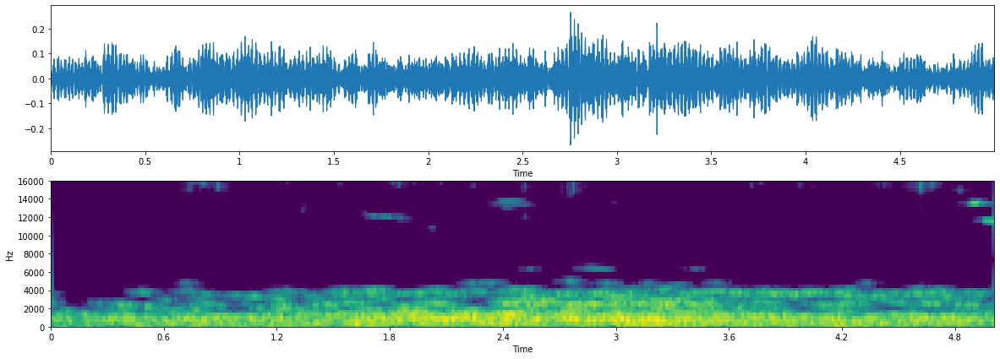

In [85]:
plot_shift(sig_splits[1], rate=rate)

In [78]:
# Load the best checkpoint
model = tf.keras.models.load_model(model_dir + 'best_model.h5')

# Pick a soundscape
soundscape_path = soundscape_dir + 'train_soundscapes/28933_SSW_20170408.ogg'

# Open it with librosa
sig, rate = librosa.load(soundscape_path, sr=SAMPLE_RATE)
# Reduce noise
sig = reduce_noise(sig, noise)

# Store results so that we can analyze them later
data = {'row_id': [], 'prediction': [], 'score': []}

# Split signal into 5-second chunks
# Just like we did before (well, this could actually be a seperate function)
sig_splits = []
for i in range(0, len(sig), int(SIGNAL_LENGTH * SAMPLE_RATE)):
    split = sig[i:i + int(SIGNAL_LENGTH * SAMPLE_RATE)]

    # End of signal?
    if len(split) < int(SIGNAL_LENGTH * SAMPLE_RATE):
        break

    sig_splits.append(split)
    
# Get the spectrograms and run inference on each of them
# This should be the exact same process as we used to
# generate training samples!
seconds, scnt = 0, 0
for chunk in tqdm(sig_splits, smoothing=0.01):
    
    # Keep track of the end time of each chunk
    seconds += 5
        
    # Get the spectrogram
    hop_length = int(SIGNAL_LENGTH * SAMPLE_RATE / (SPEC_SHAPE[1] - 1))
    mel_spec = librosa.feature.melspectrogram(y=chunk, 
                                              sr=SAMPLE_RATE, 
                                              n_fft=1024, 
                                              hop_length=hop_length, 
                                              n_mels=SPEC_SHAPE[0], 
                                              fmin=FMIN, 
                                              fmax=FMAX)

    mel_spec = librosa.power_to_db(mel_spec, ref=np.max) 

    # Normalize to match the value range we used during training.
    # That's something you should always double check!
    mel_spec -= mel_spec.min()
    mel_spec /= mel_spec.max()
    
    # Add channel axis to 2D array
    mel_spec = np.expand_dims(mel_spec, -1)

    # Add new dimension for batch size
    mel_spec = np.expand_dims(mel_spec, 0)
    
    # Predict
    p = model.predict(mel_spec)[0]
    
    # Get highest scoring species
    idx = p.argmax()
    species = LABELS[idx]
    score = p[idx]
    
    #print(soundscape_path)
    
    # Prepare submission entry
    data['row_id'].append(soundscape_path.split('/')[-1].rsplit('_', 1)[0] + 
                          '_' + str(seconds))    
    
    # Decide if it's a "nocall" or a species by applying a threshold
    if score > 0.25:
        data['prediction'].append(species)
        #print('Found a bird!')
        scnt += 1
    else:
        data['prediction'].append('nocall')
        
    # Add the confidence score as well
    data['score'].append(score)
        
print('SOUNSCAPE ANALYSIS DONE. FOUND {} BIRDS.'.format(scnt))

  0%|          | 0/120 [00:00<?, ?it/s]

SOUNSCAPE ANALYSIS DONE. FOUND 120 BIRDS.


In [79]:
# Make a new data frame
results = pd.DataFrame(data, columns = ['row_id', 'prediction', 'score'])

# Merge with ground truth so we can inspect
gt = pd.read_csv('train_soundscape_labels.csv',)
results = pd.merge(gt, results, on='row_id')

# Get the accuracy
print('Accuracy:', round(sum([y in x for x,y in zip(results['birds'], results['prediction'])])/len(results),2), '\n')

# Let's look at the first 50 entries
results.head(50)

Accuracy: 0.03 



,row_id,site,audio_id,seconds,birds,prediction,score
0,28933_SSW_5,SSW,28933,5,sonspa,rucspa1,0.399773
1,28933_SSW_10,SSW,28933,10,rewbla,comrav,0.999934
2,28933_SSW_15,SSW,28933,15,sonspa,comrav,0.989213
3,28933_SSW_20,SSW,28933,20,sonspa,comrav,0.845769
4,28933_SSW_25,SSW,28933,25,sonspa,comrav,0.993277
5,28933_SSW_30,SSW,28933,30,sonspa,comrav,0.998829
6,28933_SSW_35,SSW,28933,35,sonspa,comrav,0.996179
7,28933_SSW_40,SSW,28933,40,sonspa,comrav,0.990466
8,28933_SSW_45,SSW,28933,45,sonspa,comrav,0.991519
9,28933_SSW_50,SSW,28933,50,sonspa,comrav,0.999767


In [80]:
# Correct predictions
results.iloc[[y in x for x,y in zip(results['birds'], results['prediction'])]]

,row_id,site,audio_id,seconds,birds,prediction,score
10,28933_SSW_55,SSW,28933,55,sonspa,sonspa,0.398240
13,28933_SSW_70,SSW,28933,70,sonspa,sonspa,0.927007
30,28933_SSW_155,SSW,28933,155,gockin norcar sonspa,sonspa,0.837030
